In [73]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

### k-mean

In [74]:
def euclidean_distance(point1, point2):
    return np.sqrt(np.sum((point1 - point2) ** 2))

In [75]:
def assign_cluster(data,centroids):
  labels = []
  distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)
  labels = np.argmin(distances, axis=1)
  return labels

In [76]:
def update_centroids(data,labels,n_clusters):
  new_centroids = []
  for i in range(n_clusters):
      cluster_points = data[labels == i]
      new_centroids.append(cluster_points.mean(axis=0))

  return np.array(new_centroids)

In [77]:
def kmeans(data, n_clusters, max_iterations=100):
    # Set random seed for reproducibility
    np.random.seed(42)

    # Initialize centroids
    centroids = data[np.random.choice(data.shape[0], n_clusters, replace=False)]

    for _ in range(max_iterations):
        # Assign cluster
        labels = assign_cluster(data, centroids)

        # Update centroid
        new_centroids = update_centroids(data, labels, n_clusters)

        # Check convergence
        if np.array_equal(centroids, new_centroids):
            break

        centroids = new_centroids

    return centroids

In [78]:
def k_means_clustering(n_clusters, X_train):
    np.random.seed(0)
    centers = X_train[np.random.choice(X_train.shape[0], n_clusters, replace=False)]
    prev_centers = np.zeros(centers.shape)

    while np.linalg.norm(centers - prev_centers) > 1e-4:
        prev_centers = centers.copy()
        distances = np.linalg.norm(X_train[:, np.newaxis] - centers, axis=2)
        clusters = np.argmin(distances, axis=1)
        centers = np.array([X_train[clusters == k].mean(axis=0) for k in range(n_clusters)])

    return centers, clusters

In [79]:
def compute_scale_factor(centers, n_clusters):
    distances = [np.linalg.norm(centers[i] - centers[j]) for i in range(n_clusters) for j in range(i + 1, n_clusters)]
    return 2*np.sqrt(np.mean(distances))

### gaussian

In [80]:
def gaussian_basis(x, centers, scale_factor):
    return np.exp(-np.linalg.norm(x - centers, axis=1) ** 2 / (scale_factor))

In [81]:
# Gaussian basis regression with regularization
def fit_gaussian_basis_regression(X_train, y_train, X_test, y_test, n_clusters, reg_param=0):
    centers = kmeans(X_train, n_clusters)
    scale_factor = compute_scale_factor(centers, n_clusters)

    phi_train = np.array([gaussian_basis(x, centers, scale_factor) for x in X_train])
    phi_test = np.array([gaussian_basis(x, centers, scale_factor) for x in X_test])

    regularization_matrix = reg_param * np.eye(phi_train.shape[1])
    weights = np.linalg.pinv(phi_train.T @ phi_train + regularization_matrix) @ phi_train.T @ y_train

    y_train_pred = phi_train @ weights
    y_test_pred = phi_test @ weights

    train_mse = np.mean((y_train - y_train_pred) ** 2)
    test_mse = np.mean((y_test - y_test_pred) ** 2)

    return y_train_pred, y_test_pred,train_mse,test_mse, centers, scale_factor, weights

### cross-validate

In [82]:
# def cross_validate(X_train, y_train, X_test, y_test, complexities, reg_values):
#     best_reg_param = None
#     best_n_clusters = None
#     best_mse = float('inf')

#     for reg in reg_values:
#         for n_clusters in complexities:
#             y_train_pred,_,train_mse,_, centers,_, weights = fit_gaussian_basis_regression(
#                 X_train, y_train, X_test, y_test, n_clusters, reg
#             )

#             print(f'Regularization: {reg}, Complexity: {n_clusters}, Train MSE: {train_mse}')

#             if train_mse < best_mse:
#                 best_mse = train_mse
#                 best_reg_param = reg
#                 best_n_clusters = n_clusters
#                 best_weights = weights

#     return best_reg_param, best_mse, best_n_clusters, best_weights

def cross_validate(X_train, y_train, X_test, y_test, complexities, reg_values):
    best_reg_param = None
    best_n_clusters = None
    best_mse = float('inf')
    results = []

    for reg in reg_values:
        for n_clusters in complexities:
            y_train_pred, _, train_mse, test_mse, centers, _, weights = fit_gaussian_basis_regression(
                X_train, y_train, X_test, y_test, n_clusters, reg
            )

            print(f'Regularization: {reg}, Complexity: {n_clusters}, Train MSE: {train_mse}, Test MSE: {test_mse}')
            results.append((reg, n_clusters, train_mse, y_train_pred))

            if test_mse < best_mse:
                best_mse = test_mse
                best_reg_param = reg
                best_n_clusters = n_clusters
                best_weights = weights

    return best_reg_param, best_mse, best_n_clusters, best_weights, results


### reading data

In [83]:
# The error suggests that the dataframe columns should be accessed using column names rather than integer indices.
# Let's inspect the first few rows of the dataframe to adjust the column referencing.

df = pd.read_csv('6.csv',header=None)
df_train = df[:int(len(df)*0.7)]
df_test = df[int(len(df)*0.7):]

# # # Print the columns of the dataframe to see available column names
# # print(df.columns)

X_train = df_train[[0, 1]]
Y_train = df_train[2]

X_test = df_test[[0, 1]]
Y_test = df_test[2]

print(X_train, Y_train, X_test, Y_test)

         0     1
0     0.28  0.00
1     0.58  0.70
2     0.72  0.43
3     0.70  0.39
4     0.98  0.15
...    ...   ...
7135  0.10  0.38
7136  0.21  0.73
7137  0.20  0.80
7138  0.15  0.52
7139  0.44  0.29

[7140 rows x 2 columns] 0      -0.22935
1       6.14400
2       4.04830
3       3.61540
4       2.53830
         ...   
7135    4.50380
7136    7.55080
7137    8.26700
7138    5.74700
7139    1.85090
Name: 2, Length: 7140, dtype: float64           0     1
7140   0.55  0.99
7141   0.73  0.39
7142   0.54  0.23
7143   0.43  0.05
7144   0.57  0.91
...     ...   ...
10196  0.05  0.78
10197  0.59  0.68
10198  0.32  0.87
10199  0.14  0.69
10200  0.54  0.42

[3061 rows x 2 columns] 7140     8.94810
7141     3.78350
7142     1.34420
7143    -0.38005
7144     8.15860
          ...   
10196    8.72890
10197    5.97450
10198    8.24040
10199    7.46280
10200    3.15760
Name: 2, Length: 3061, dtype: float64


### printing best M.S.E.

In [84]:
complexities = [2, 4, 8, 16, 32,64 ,128, 256]
reg_values = [0, 0.000001, 0.001, 0.01, 0.1, 1]

# The error indicates an issue with how DataFrame columns are being accessed.
# X_train is a pandas DataFrame and when doing slicing operations should be converted to numpy arrays accordingly.
# Need to replace DataFrame operations with numpy array operations or use DataFrame accessors correctly.

# Convert DataFrames to numpy arrays
X_train_np = X_train.values
Y_train_np = Y_train.values

# Update function call with numpy arrays
best_reg_param, best_mse, best_n_clusters, weights,results = cross_validate(X_train_np, Y_train_np, X_test.values, Y_test.values, complexities, reg_values)
print(f'Best Regularization Parameter: {best_reg_param}, Best MSE: {best_mse}, Best Complexity (Degree): {best_n_clusters}')




Regularization: 0, Complexity: 2, Train MSE: 1.0196702313292112, Test MSE: 1.0638862939980287
Regularization: 0, Complexity: 4, Train MSE: 0.9425400592726604, Test MSE: 0.9826507427280182
Regularization: 0, Complexity: 8, Train MSE: 0.046268900789076105, Test MSE: 0.047165170485241575
Regularization: 0, Complexity: 16, Train MSE: 0.00392891928481412, Test MSE: 0.003989561650675836
Regularization: 0, Complexity: 32, Train MSE: 0.00326587613261003, Test MSE: 0.0032616894782820783
Regularization: 0, Complexity: 64, Train MSE: 0.0032816213981235057, Test MSE: 0.0032518709845019878
Regularization: 0, Complexity: 128, Train MSE: 0.0032586974414469403, Test MSE: 0.0032521964168822724
Regularization: 0, Complexity: 256, Train MSE: 0.0032583974553401706, Test MSE: 0.0032474378774520105
Regularization: 1e-06, Complexity: 2, Train MSE: 1.0196702313292119, Test MSE: 1.0638862953016834
Regularization: 1e-06, Complexity: 4, Train MSE: 0.9425400592726606, Test MSE: 0.9826507431295742
Regularization: 

### plotting

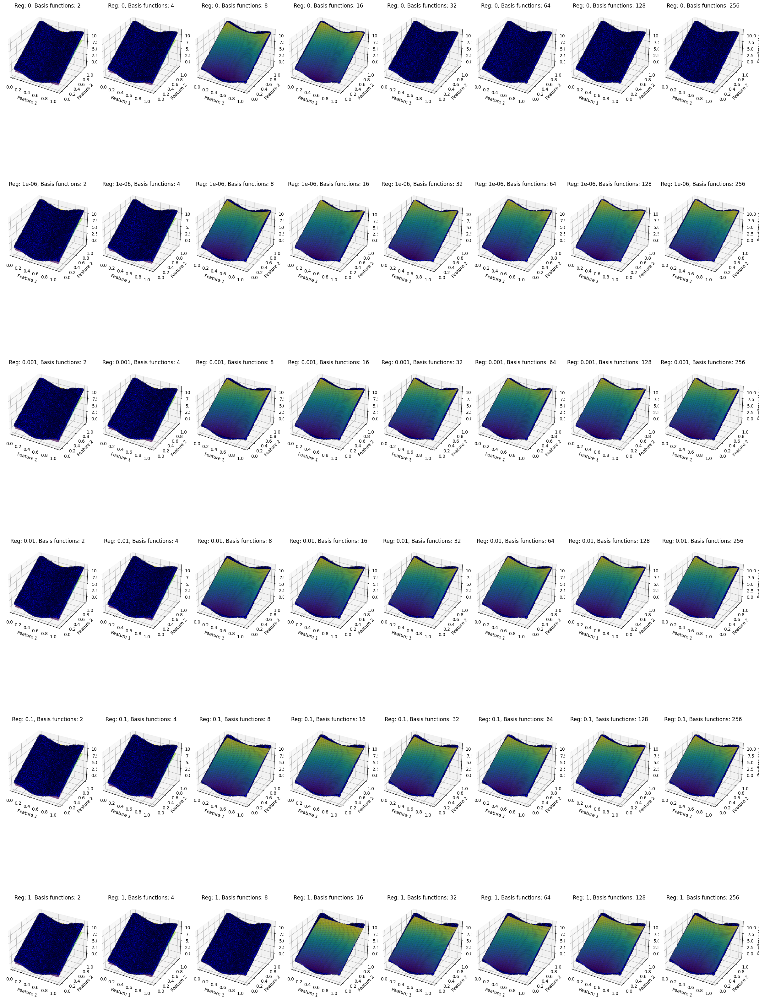

In [92]:
# from mpl_toolkits.mplot3d import Axes3D

# # Create a function to fit the model and return predictions for 3D plotting
# def fit_and_predict(X_train, y_train, n_clusters, reg_param):
#     y_train_pred, _, _, _, centers, scale_factor, weights = fit_gaussian_basis_regression(
#         X_train, y_train, X_train, y_train, n_clusters, reg_param
#     )
#     return centers, scale_factor, weights, y_train_pred

# # Prepare a grid of values for plotting
# x1_range = np.linspace(X_train_np[:, 0].min(), X_train_np[:, 0].max(), 100)
# x2_range = np.linspace(X_train_np[:, 1].min(), X_train_np[:, 1].max(), 100)
# X1, X2 = np.meshgrid(x1_range, x2_range)
# grid_points = np.c_[X1.ravel(), X2.ravel()]

# # Create a figure for the 3D plots
# fig = plt.figure(figsize=(30, 24))
# num_plots = len(complexities) * len(reg_values)
# plot_index = 1

# # Loop through complexities and regularization values
# for reg in reg_values:
#     for n_clusters in complexities:
#         # Fit the model and get predictions
#         centers, scale_factor, weights, y_train_pred = fit_and_predict(X_train_np, Y_train_np, n_clusters, reg)

#         # Get predictions for the grid points
#         phi_grid = np.array([gaussian_basis(x, centers, scale_factor) for x in grid_points])
#         y_grid_pred = phi_grid @ weights

#         # Reshape predictions to the grid shape for plotting
#         Y_grid = y_grid_pred.reshape(X1.shape)

#         # Create a subplot for the current combination
#         ax = fig.add_subplot(len(reg_values), len(complexities), plot_index, projection='3d')
#         ax.scatter(X_train_np[:, 0], X_train_np[:, 1], Y_train_np, color='blue', label='Training Data', alpha=0.5)
#         ax.plot_surface(X1, X2, Y_grid, cmap='viridis', alpha=0.7)

#         # Set plot titles and labels
#         ax.set_title(f'Reg: {reg}, Clusters: {n_clusters}')
#         ax.set_xlabel('Feature 1')
#         ax.set_ylabel('Feature 2')
#         ax.set_zlabel('Predicted Value')

#         plot_index += 1

# # Adjust layout and show the plot
# plt.tight_layout()
# plt.show()

from mpl_toolkits.mplot3d import Axes3D

# Create a function to fit the model and return predictions for 3D plotting
def fit_and_predict(X_train, y_train, n_clusters, reg_param):
    y_train_pred, _, _, _, centers, scale_factor, weights = fit_gaussian_basis_regression(
        X_train, y_train, X_train, y_train, n_clusters, reg_param
    )
    return centers, scale_factor, weights, y_train_pred

# Prepare a grid of values for plotting
x1_range = np.linspace(X_train_np[:, 0].min(), X_train_np[:, 0].max(), 100)
x2_range = np.linspace(X_train_np[:, 1].min(), X_train_np[:, 1].max(), 100)
X1, X2 = np.meshgrid(x1_range, x2_range)
grid_points = np.c_[X1.ravel(), X2.ravel()]

# Create a figure for the 3D plots
fig = plt.figure(figsize=(24, 36))  # Adjusted width to fit two plots nicely
num_plots = len(complexities) * len(reg_values)
plot_index = 1

# Loop through complexities and regularization values
for reg in reg_values:
    for n_clusters in complexities:
        # Fit the model and get predictions
        centers, scale_factor, weights, y_train_pred = fit_and_predict(X_train_np, Y_train_np, n_clusters, reg)

        # Get predictions for the grid points
        phi_grid = np.array([gaussian_basis(x, centers, scale_factor) for x in grid_points])
        y_grid_pred = phi_grid @ weights

        # Reshape predictions to the grid shape for plotting
        Y_grid = y_grid_pred.reshape(X1.shape)

        # Create a subplot for the current combination
        ax = fig.add_subplot(len(reg_values), len(complexities), plot_index, projection='3d')  # Use len(complexities) for columns
        ax.scatter(X_train_np[:, 0], X_train_np[:, 1], Y_train_np, color='blue', label='Training Data',
                   alpha=0.5, s=20, edgecolor='black')  # Smaller point size and black border
        ax.plot_surface(X1, X2, Y_grid, cmap='viridis', alpha=0.7)

        # Set plot titles and labels
        ax.set_title(f'Reg: {reg}, Basis functions: {n_clusters}')
        ax.set_xlabel('Feature 1')
        ax.set_ylabel('Feature 2')
        ax.set_zlabel('Predicted Value')

        plot_index += 1

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


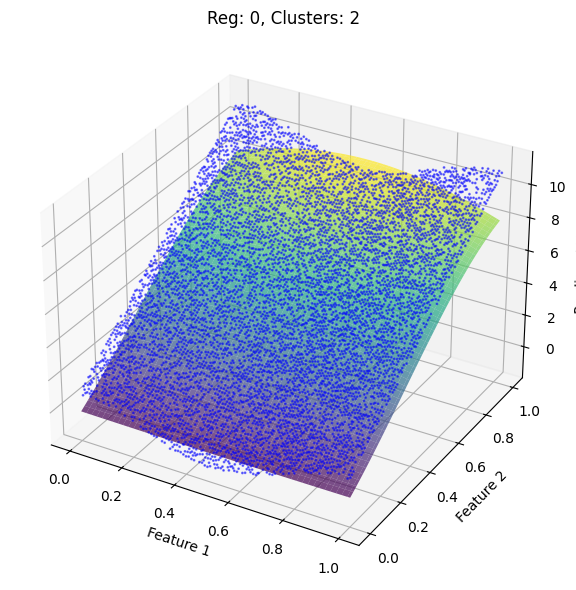

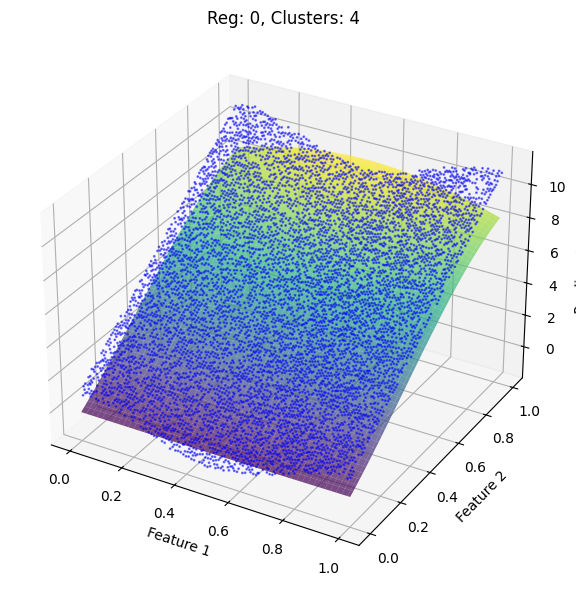

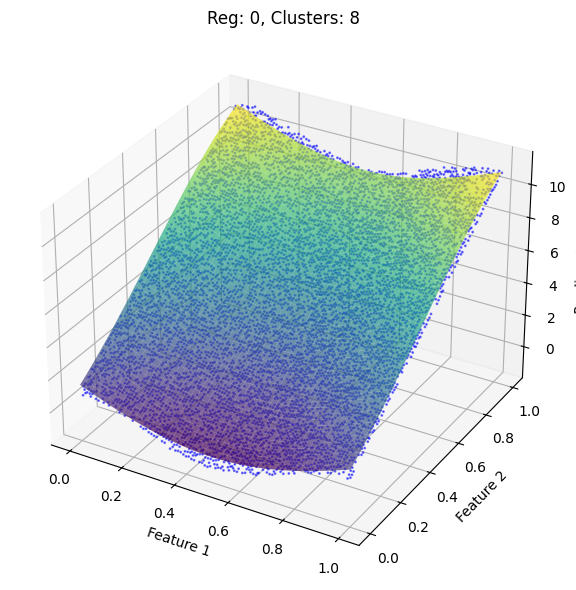

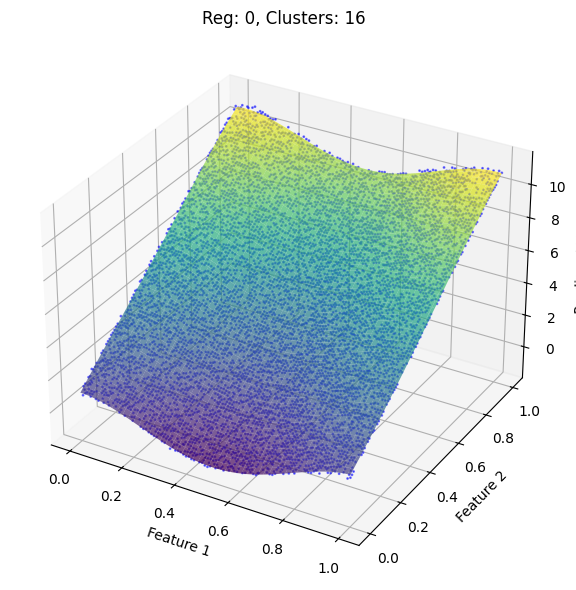

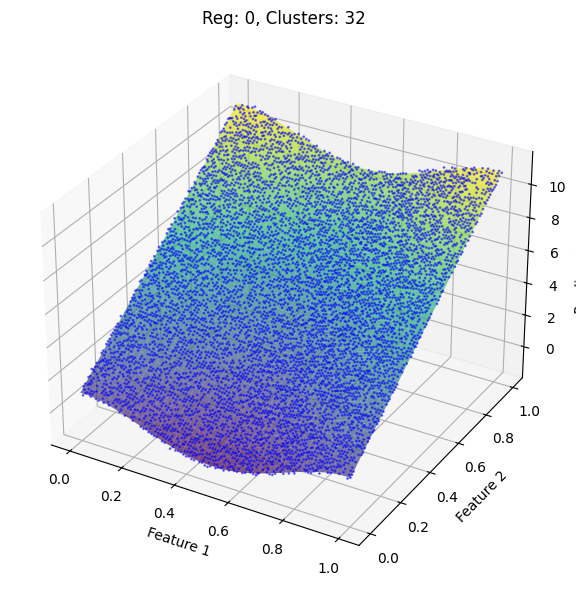

...

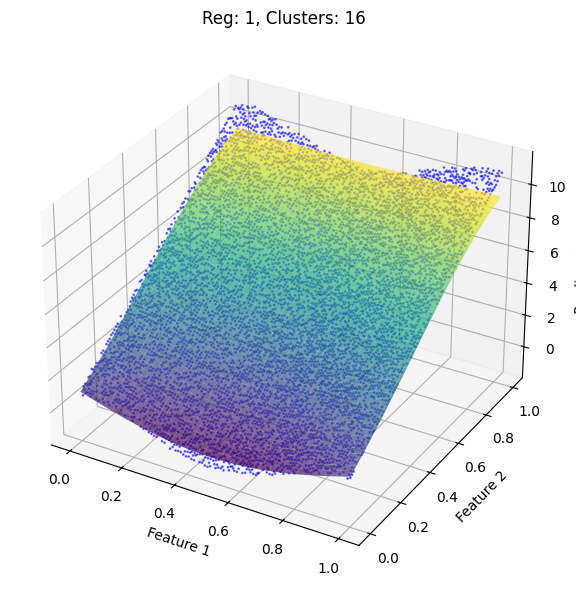

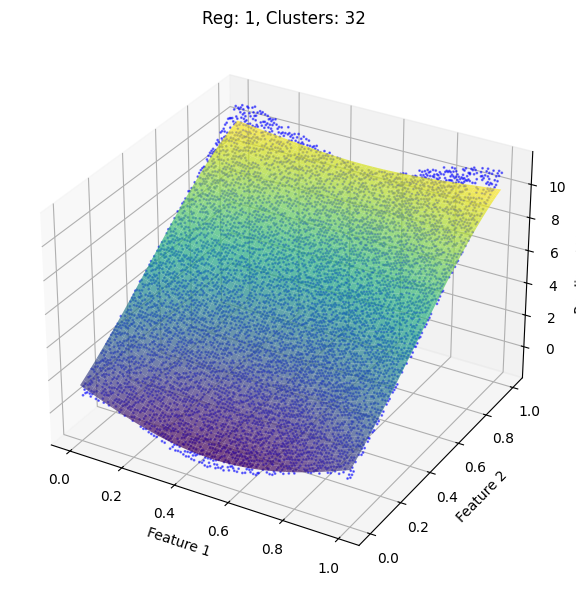

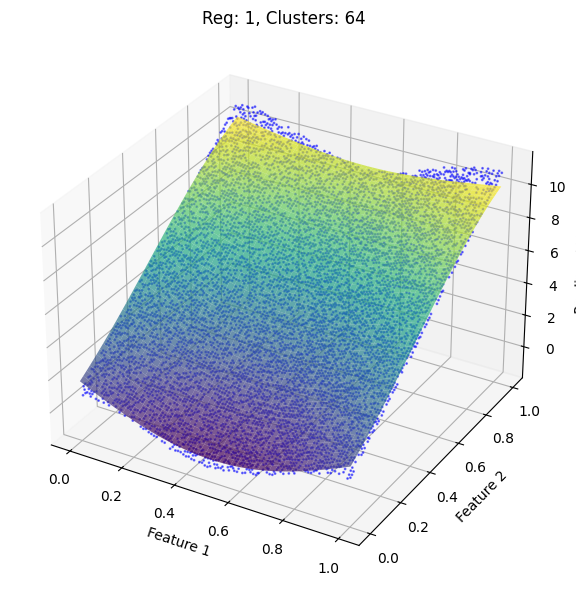

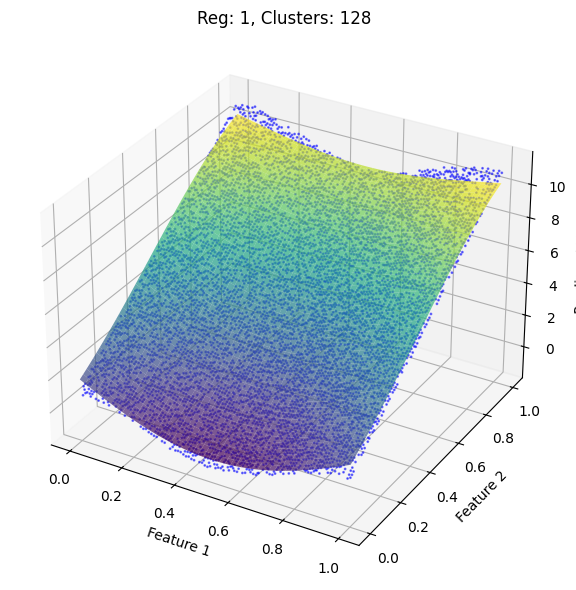

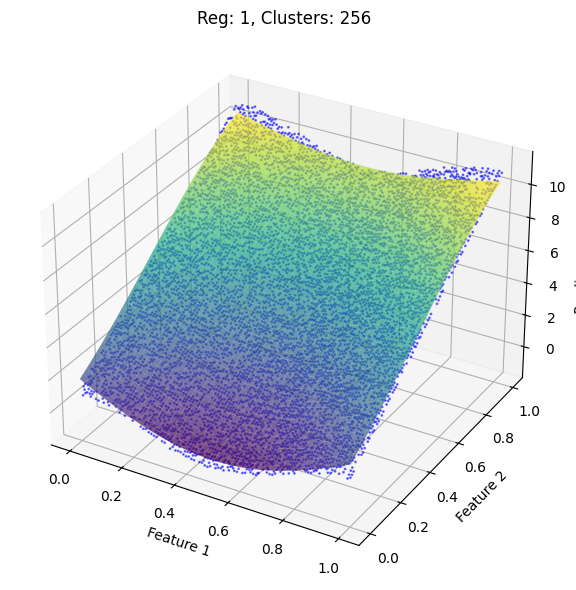

In [86]:
from mpl_toolkits.mplot3d import Axes3D

# Create a function to fit the model and return predictions for 3D plotting
def fit_and_predict(X_train, y_train, n_clusters, reg_param):
    y_train_pred, _, _, _, centers, scale_factor, weights = fit_gaussian_basis_regression(
        X_train, y_train, X_train, y_train, n_clusters, reg_param
    )
    return centers, scale_factor, weights, y_train_pred

# Prepare a grid of values for plotting
x1_range = np.linspace(X_train_np[:, 0].min(), X_train_np[:, 0].max(), 100)
x2_range = np.linspace(X_train_np[:, 1].min(), X_train_np[:, 1].max(), 100)
X1, X2 = np.meshgrid(x1_range, x2_range)
grid_points = np.c_[X1.ravel(), X2.ravel()]

# Loop through complexities and regularization values
for reg in reg_values:
    for n_clusters in complexities:
        # Fit the model and get predictions
        centers, scale_factor, weights, y_train_pred = fit_and_predict(X_train_np, Y_train_np, n_clusters, reg)

        # Get predictions for the grid points
        phi_grid = np.array([gaussian_basis(x, centers, scale_factor) for x in grid_points])
        y_grid_pred = phi_grid @ weights

        # Reshape predictions to the grid shape for plotting
        Y_grid = y_grid_pred.reshape(X1.shape)

        # Create a new figure for the current combination
        fig = plt.figure(figsize=(8, 6))  # Increase figure size
        ax = fig.add_subplot(111, projection='3d')


        # Plot training data
        ax.scatter(X_train_np[:, 0], X_train_np[:, 1], Y_train_np, color='blue', label='Training Data', alpha=0.5,s=1)

        # Plot the fitted surface
        ax.plot_surface(X1, X2, Y_grid, cmap='viridis', alpha=0.7)

        # Set plot titles and labels
        ax.set_title(f'Reg: {reg}, Clusters: {n_clusters}')
        ax.set_xlabel('Feature 1')
        ax.set_ylabel('Feature 2')
        ax.set_zlabel('Predicted Value')
        # Show the plot
        plt.tight_layout()
        plt.show()

### mse plotting

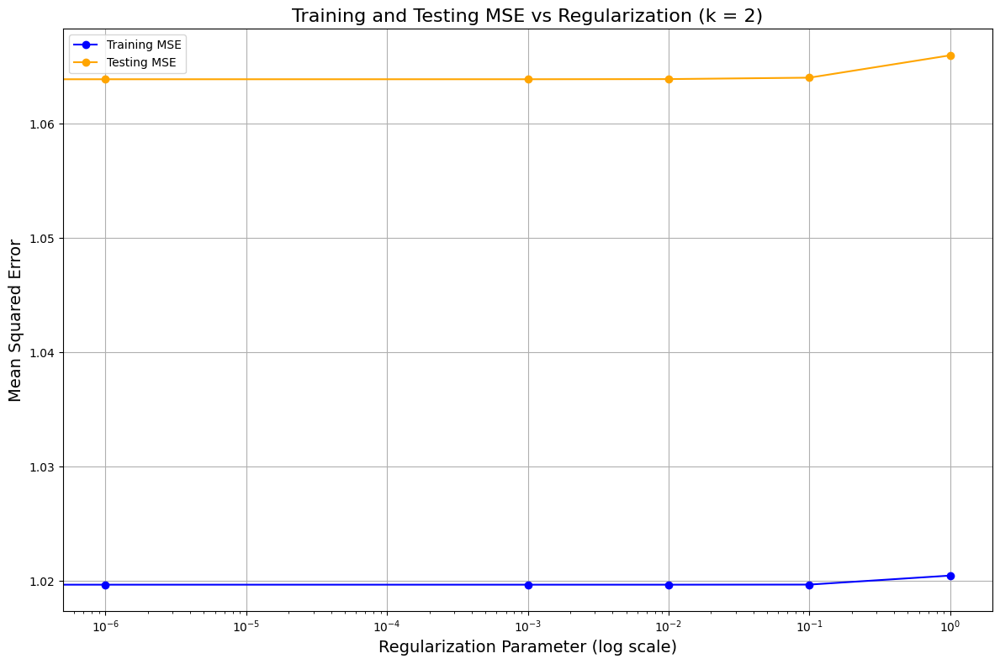

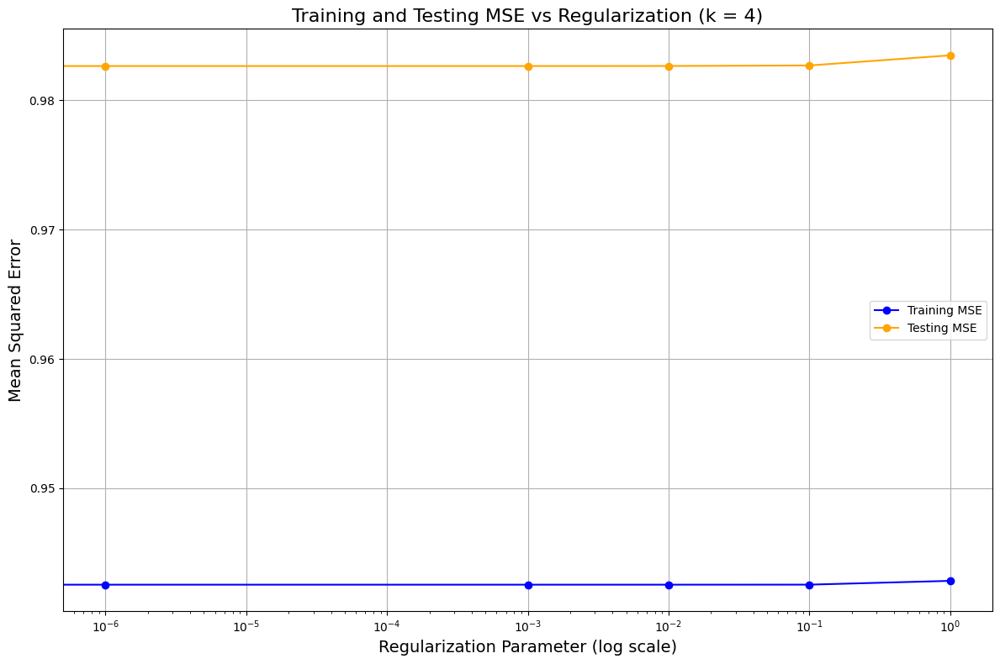

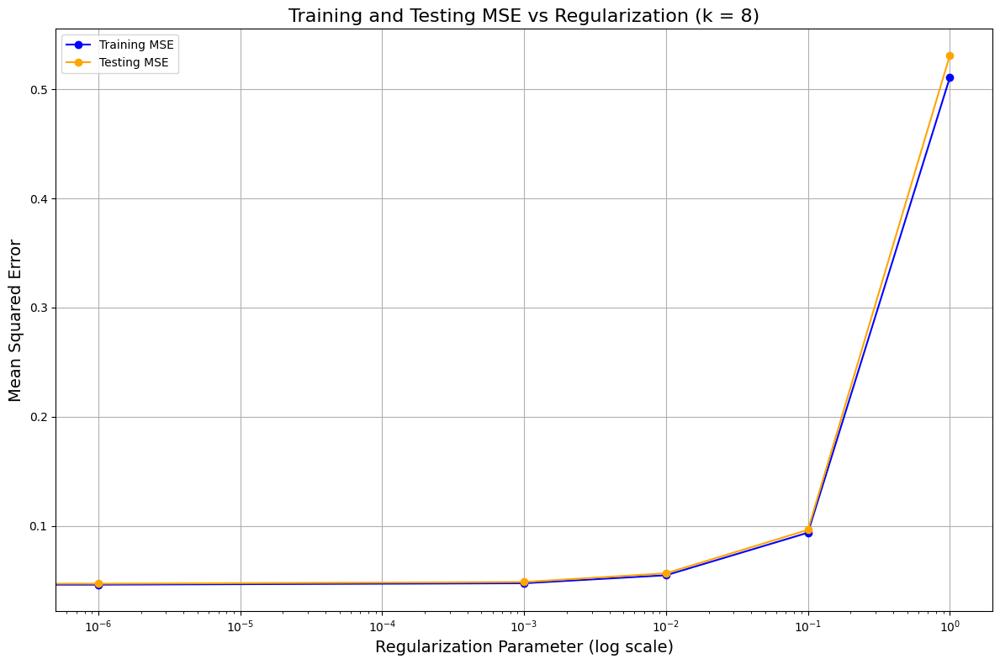

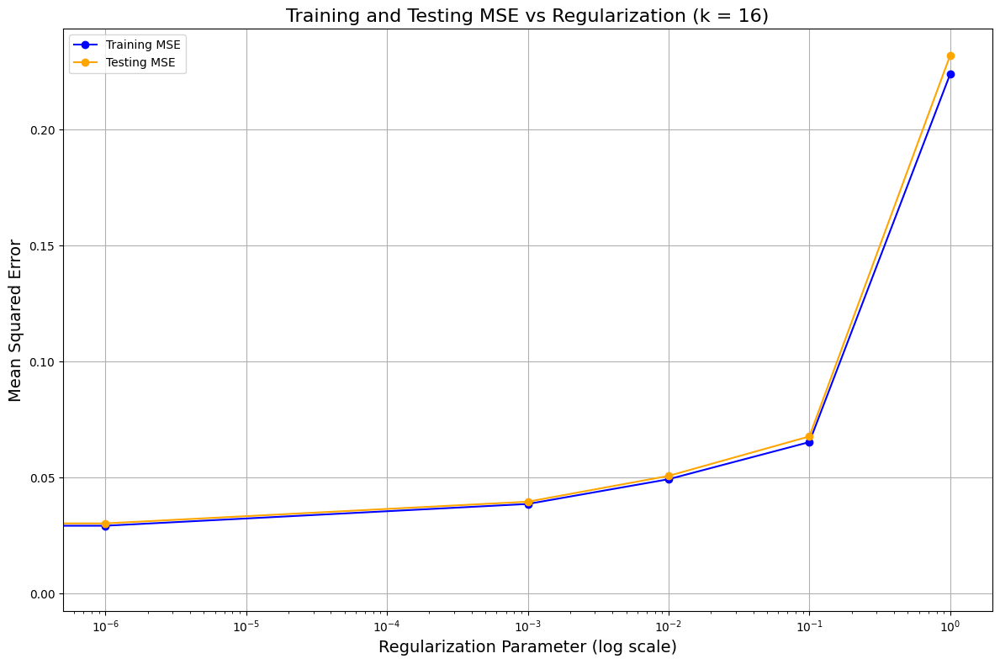

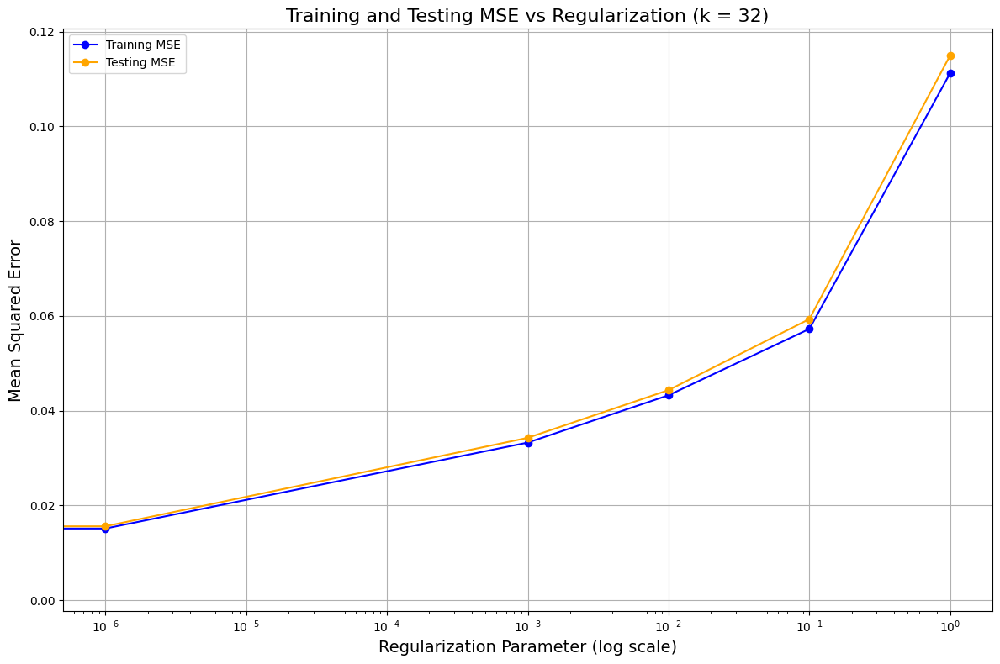

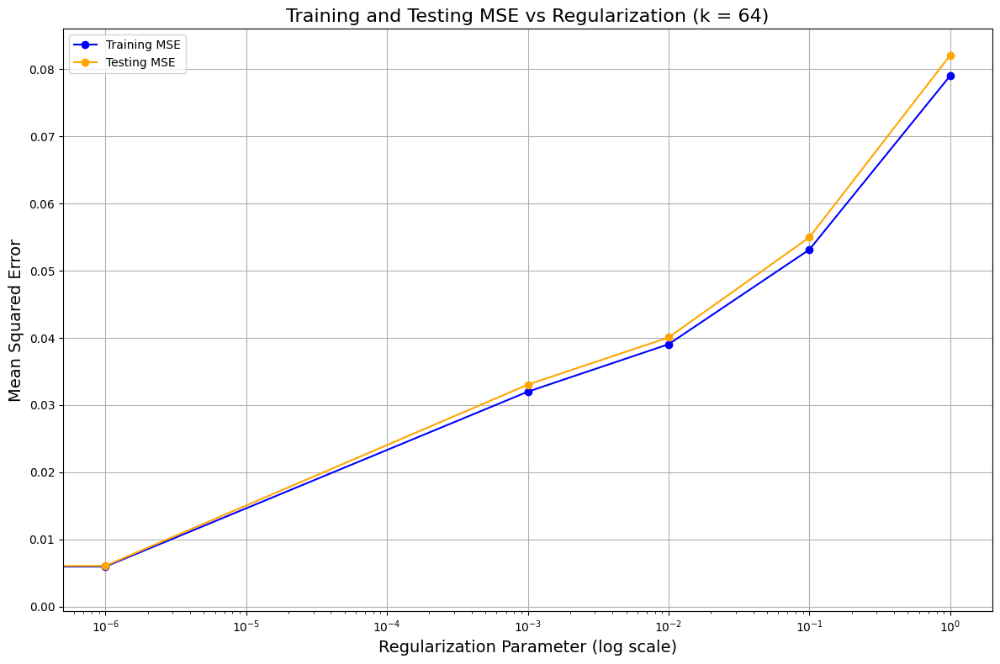

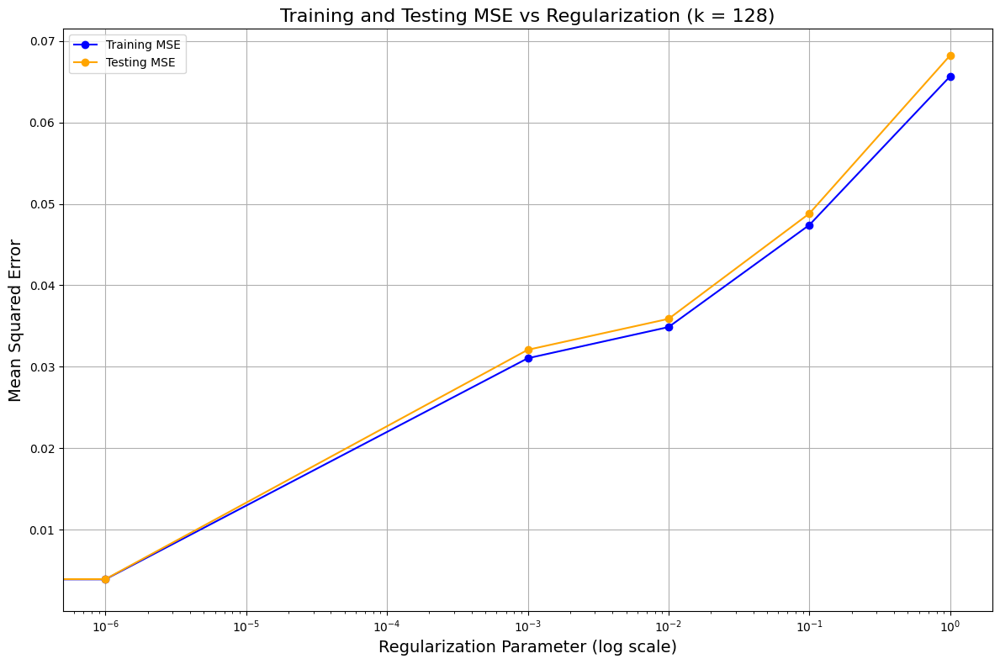

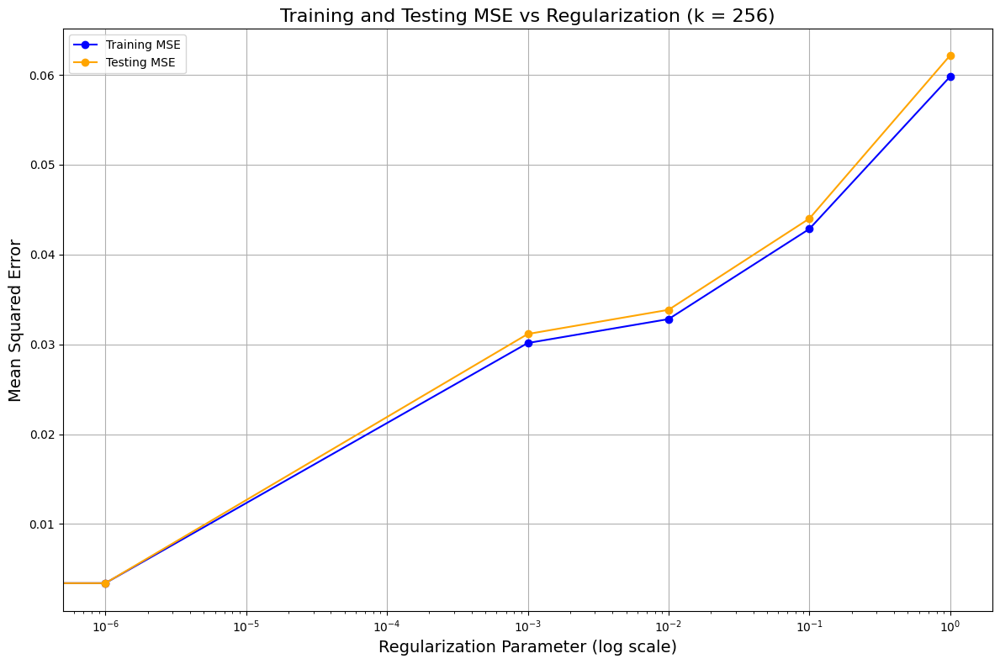

In [87]:
# Choose a specific number of clusters (k)
k = [2,4,8,16,32,64,128,256]  # You can adjust this value as needed
for k in k:
    # Initialize lists to store MSE values
    train_mse_values = []
    test_mse_values = []

    # Loop through the regularization values
    for reg in reg_values:
        # Fit the model and get predictions
        y_train_pred, y_test_pred, train_mse, test_mse, centers, scale_factor, weights = fit_gaussian_basis_regression(
            X_train_np, Y_train_np, X_test.values, Y_test.values, k, reg
        )

        # Append the MSE values
        train_mse_values.append(train_mse)
        test_mse_values.append(test_mse)

    # Plotting the MSE values against regularization
    plt.figure(figsize=(12, 8))
    plt.plot(reg_values, train_mse_values, marker='o', label='Training MSE', color='blue')
    plt.plot(reg_values, test_mse_values, marker='o', label='Testing MSE', color='orange')
    plt.xscale('log')  # Log scale for better visualization of MSE vs regularization
    plt.xlabel('Regularization Parameter (log scale)', fontsize=14)
    plt.ylabel('Mean Squared Error', fontsize=14)
    plt.title(f'Training and Testing MSE vs Regularization (k = {k})', fontsize=16)
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


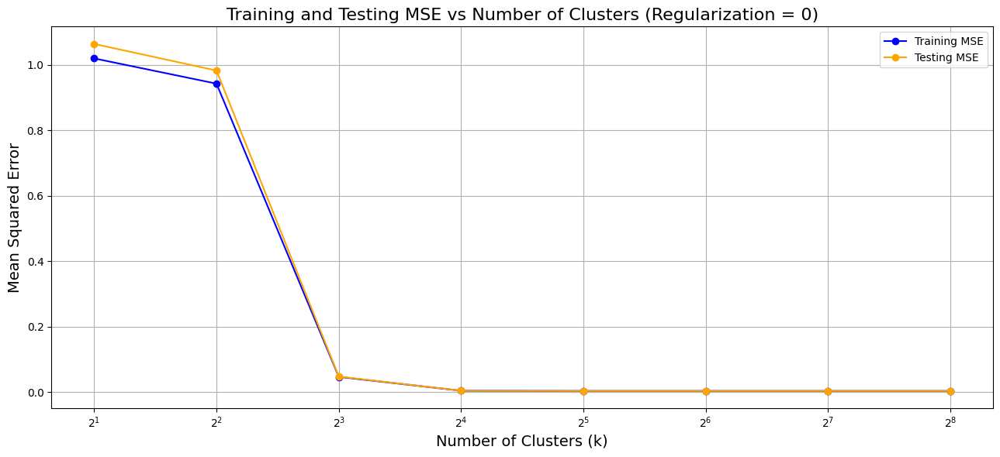

In [88]:
import matplotlib.pyplot as plt

# Choose a specific number of clusters (k)
k_values = [2, 4, 8, 16, 32,64, 128, 256]  # Values of k to test
reg = 0  # Set regularization parameter to 0
train_mse_values = []
test_mse_values = []

# Loop through the different values of k
for k in k_values:
    # Fit the model and get predictions
    y_train_pred, y_test_pred, train_mse, test_mse, centers, scale_factor, weights = fit_gaussian_basis_regression(
        X_train_np, Y_train_np, X_test.values, Y_test.values, k, reg
    )

    # Append the MSE values
    train_mse_values.append(train_mse)
    test_mse_values.append(test_mse)

# Plotting the MSE values against the number of clusters k
plt.figure(figsize=(13,6))
plt.plot(k_values, train_mse_values, marker='o', label='Training MSE', color='blue')
plt.plot(k_values, test_mse_values, marker='o', label='Testing MSE', color='orange')

plt.xscale('log',base=2)


plt.xlabel('Number of Clusters (k)', fontsize=14)
plt.ylabel('Mean Squared Error', fontsize=14)
plt.title(f'Training and Testing MSE vs Number of Clusters (Regularization = {reg})', fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

### scatter plot

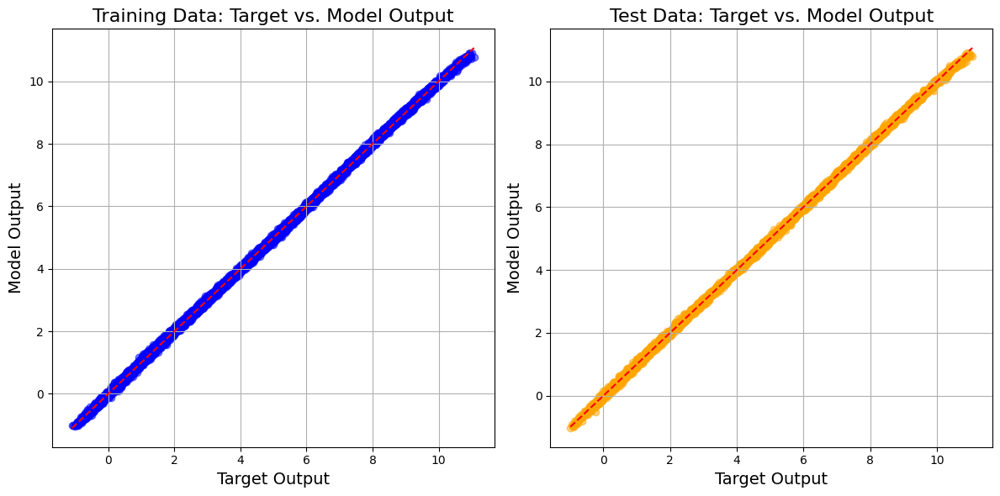

In [89]:
# Set the specific regularization value and complexity
reg_param = 0
n_clusters = 16

# Fit the model on the training data
y_train_pred, y_test_pred, _, _, centers, scale_factor, weights = fit_gaussian_basis_regression(
    X_train_np, Y_train_np, X_test.values, Y_test.values, n_clusters, reg_param
)

# Create scatter plot for training data
plt.figure(figsize=(12, 6))

# Training Data Plot
plt.subplot(1, 2, 1)
plt.scatter(Y_train_np, y_train_pred, color='blue', alpha=0.5)
plt.plot([Y_train_np.min(), Y_train_np.max()], [Y_train_np.min(), Y_train_np.max()], color='red', linestyle='--')  # Ideal line
plt.xlabel('Target Output', fontsize=14)
plt.ylabel('Model Output', fontsize=14)
plt.title('Training Data: Target vs. Model Output', fontsize=16)
plt.grid(True)

# Test Data Plot
plt.subplot(1, 2, 2)
plt.scatter(Y_test.values, y_test_pred, color='orange', alpha=0.5)
plt.plot([Y_test.values.min(), Y_test.values.max()], [Y_test.values.min(), Y_test.values.max()], color='red', linestyle='--')  # Ideal line
plt.xlabel('Target Output', fontsize=14)
plt.ylabel('Model Output', fontsize=14)
plt.title('Test Data: Target vs. Model Output', fontsize=16)
plt.grid(True)

# Adjust layout and show the plots
plt.tight_layout()
plt.show()


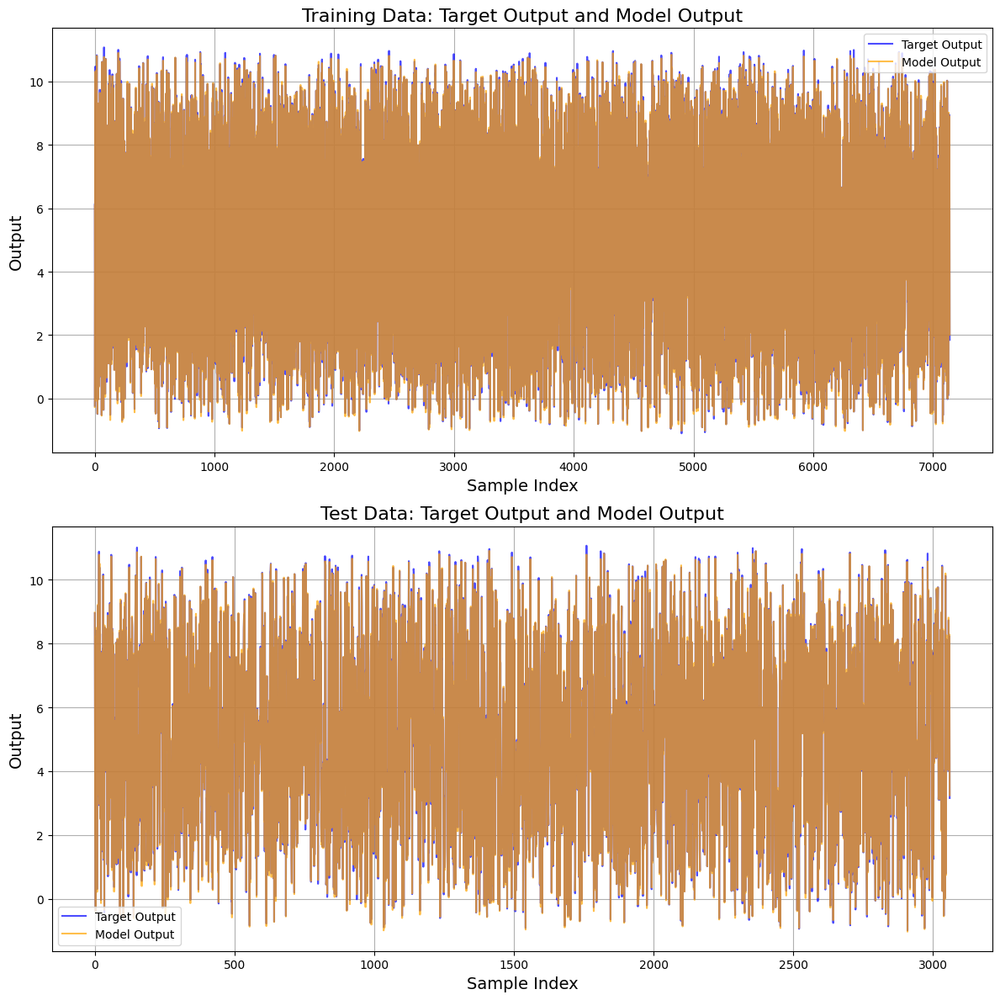

In [90]:
# Set the specific regularization value and complexity
reg_param = 0
n_clusters = 16

# Fit the model on the training data
y_train_pred, y_test_pred, _, _, centers, scale_factor, weights = fit_gaussian_basis_regression(
    X_train_np, Y_train_np, X_test.values, Y_test.values, n_clusters, reg_param
)

# Create a figure for the plots
plt.figure(figsize=(12, 12))

# Training Data Plot
plt.subplot(2, 1, 1)
plt.plot(Y_train_np, label='Target Output', color='blue', alpha=0.7)
plt.plot(y_train_pred, label='Model Output', color='orange', alpha=0.7)
plt.title('Training Data: Target Output and Model Output', fontsize=16)
plt.xlabel('Sample Index', fontsize=14)
plt.ylabel('Output', fontsize=14)
plt.legend()
plt.grid(True)

# Test Data Plot
plt.subplot(2, 1, 2)
plt.plot(Y_test.values, label='Target Output', color='blue', alpha=0.7)
plt.plot(y_test_pred, label='Model Output', color='orange', alpha=0.7)
plt.title('Test Data: Target Output and Model Output', fontsize=16)
plt.xlabel('Sample Index', fontsize=14)
plt.ylabel('Output', fontsize=14)
plt.legend()
plt.grid(True)

# Adjust layout and show the plots
plt.tight_layout()
plt.show()


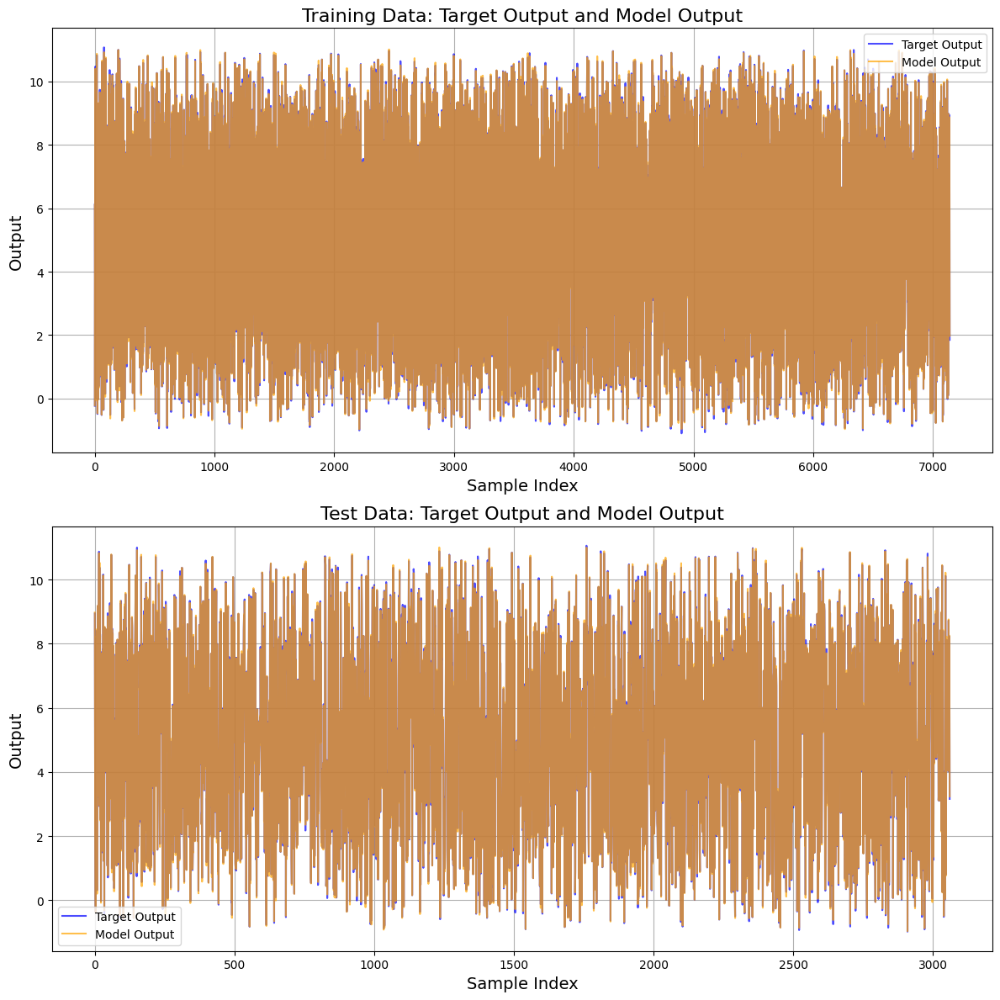

In [91]:
# Set the specific regularization value and complexity
reg_param = 0
n_clusters = 256

# Fit the model on the training data
y_train_pred, y_test_pred, _, _, centers, scale_factor, weights = fit_gaussian_basis_regression(
    X_train_np, Y_train_np, X_test.values, Y_test.values, n_clusters, reg_param
)

# Create a figure for the plots
plt.figure(figsize=(12, 12))

# Training Data Plot
plt.subplot(2, 1, 1)
plt.plot(Y_train_np, label='Target Output', color='blue', alpha=0.7)
plt.plot(y_train_pred, label='Model Output', color='orange', alpha=0.7)
plt.title('Training Data: Target Output and Model Output', fontsize=16)
plt.xlabel('Sample Index', fontsize=14)
plt.ylabel('Output', fontsize=14)
plt.legend()
plt.grid(True)

# Test Data Plot
plt.subplot(2, 1, 2)
plt.plot(Y_test.values, label='Target Output', color='blue', alpha=0.7)
plt.plot(y_test_pred, label='Model Output', color='orange', alpha=0.7)
plt.title('Test Data: Target Output and Model Output', fontsize=16)
plt.xlabel('Sample Index', fontsize=14)
plt.ylabel('Output', fontsize=14)
plt.legend()
plt.grid(True)

# Adjust layout and show the plots
plt.tight_layout()
plt.show()
